In [ ]:
from google.colab import drive           #imorting the google drive to google colab.

In [ ]:
drive.mount('/content/drive')            #mounting the drive so that we can import the datasets.

Mounted at /content/drive


In [ ]:
path = 'drive/My Drive /Datasets'        #path of the datasets present in the drive.

In [ ]:
# Discard the output of this cell.
%%capture

# Install the required libraries.
%pip install tensorflow opencv-contrib-python youtube-dl moviepy pydot
%pip install https://github.com/AtulUppin/pafy

In [ ]:
# Import the required libraries.
import os                           #importing OS module for providing functions for interacting with the operating system.
import cv2                          #importing cv2 to method loads an image from the specified file.
import pafy                         #importing pafy to download YouTube content and retrieve metadata.

import math                         #importing math gives access to the standard C library functions which gives access modules function like the math.sqrt.
import random                       #This method is used to generate a float random number less than 1 and greater or equal to 0.
import numpy as np                  #NumPy is a library that helps us handle large and multidimensional arrays and matrices.
import datetime as dt               #importing datetime to work with dates as date objects.
import tensorflow as tf             #Tensorflow is used for fast numerical computing.
from collections import deque       #Deque (Doubly Ended Queue) in Python is implemented using the module “collections“.
import matplotlib.pyplot as plt     #importing matplotlib for ploting the graphs.

from moviepy.editor import *
%matplotlib inline

from sklearn.model_selection import train_test_split

from tensorflow.keras.layers import *
from tensorflow.keras.models import Sequential
from tensorflow.keras.utils import to_categorical
from tensorflow.keras.callbacks import EarlyStopping
from tensorflow.keras.utils import plot_model

In [ ]:
seed_constant = 27                     #Setting Numpy,Python and Tensorflow seeds to get consistent results on every execution.
np.random.seed(seed_constant)
random.seed(seed_constant)
tf.random.set_seed(seed_constant)

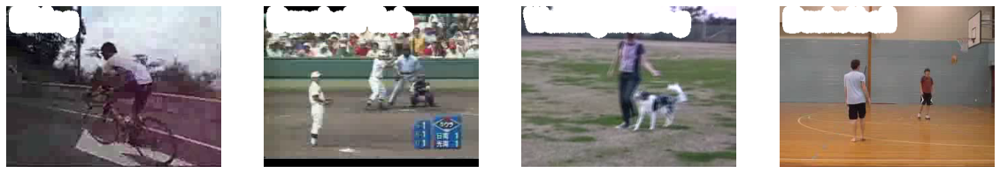

In [ ]:

plt.figure(figsize = (20, 20))  # Create a Matplotlib figure and specify the size of the figure.

all_classes_names = os.listdir('/content/drive/MyDrive/datasets/UCF50')  # Get the names of all classes/categories in UCF50.

# Generate a list of 20 random values. The values will be between 0-10,
random_range = random.sample(range(len(all_classes_names)), 4)   # where 4 is the total number of class in the dataset.

for counter, random_index in enumerate(random_range, 1):   # Iterating through all the generated random values.

    selected_class_Name = all_classes_names[random_index]   # Retrieve a Class Name using the Random Index.

    # Retrieve the list of all the video files present in the randomly selected Class Directory.
    video_files_names_list = os.listdir(f'/content/drive/MyDrive/datasets/UCF50/{selected_class_Name}')

    # Randomly select a video file from the list retrieved from the randomly selected Class Directory.
    selected_video_file_name = random.choice(video_files_names_list)

    # Initialize a VideoCapture object to read from the video File.
    video_reader = cv2.VideoCapture(f'/content/drive/MyDrive/datasets/UCF50/{selected_class_Name}/{selected_video_file_name}')


    _, bgr_frame = video_reader.read()    # Read the first frame of the video file.

    video_reader.release()                # Release the VideoCapture object.

    rgb_frame = cv2.cvtColor(bgr_frame, cv2.COLOR_BGR2RGB)  # Convert the frame from BGR into RGB format.

    # Write the class name on the video frame.
    cv2.putText(rgb_frame, selected_class_Name, (10, 30), cv2.FONT_HERSHEY_SIMPLEX, 1, (255, 255, 255), 20)

    # Display the frame.
    plt.subplot(5, 4, counter);plt.imshow(rgb_frame);plt.axis('off')

In [ ]:
IMAGE_HEIGHT , IMAGE_WIDTH = 64, 64  # Specify the height and width to which each video frame will be resized in our dataset.

SEQUENCE_LENGTH = 20  # Specify the number of frames of a video that will be fed to the model as one sequence.

DATASET_DIR = f"/content/drive/MyDrive/datasets/UCF50"  # Specify the directory containing the UCF50 dataset.

CLASSES_LIST = [ "Basketball","WalkingWithDog"]  # Specify the list containing the names of the classes used for training.

In [ ]:
def frames_extraction(video_path):   #This function will extract the required frames from a video after resizing and normalizing them.
                                     #video_path: The path of the video in the disk, whose frames are to be extracted.
                                     #frames_list: A list containing the resized and normalized frames of the video.

    frames_list = []   # Declare a list to store video frames.

    video_reader = cv2.VideoCapture(video_path) # Read the Video File using the VideoCapture object.

    video_frames_count = int(video_reader.get(cv2.CAP_PROP_FRAME_COUNT))  # Get the total number of frames in the video.

    skip_frames_window = max(int(video_frames_count/SEQUENCE_LENGTH), 1)   # Calculate the the interval after which frames will be added to the list.

    for frame_counter in range(SEQUENCE_LENGTH):   # Iterate through the Video Frames.

        video_reader.set(cv2.CAP_PROP_POS_FRAMES, frame_counter * skip_frames_window)  # Set the current frame position of the video.

        success, frame = video_reader.read()   # Reading the frame from the video.

        if not success:   # Check if Video frame is not successfully read then break the loop
            break

        resized_frame = cv2.resize(frame, (IMAGE_HEIGHT, IMAGE_WIDTH))  # Resize the Frame to fixed height and width.

        normalized_frame = resized_frame / 255  # Normalize the resized frame by dividing it with 255 so that each pixel value then lies between 0 and 1

        frames_list.append(normalized_frame)  # Append the normalized frame into the frames list

    video_reader.release()  # Release the VideoCapture object.

    return frames_list   # Return the frames list.

In [ ]:
def create_dataset():   #This function will extract the data of the selected classes and create the required dataset.

    # Declared Empty Lists to store the features, labels and video file path values.
    features = []    #features: A list containing the extracted frames of the videos.
    labels = []      #labels:   A list containing the indexes of the classes associated with the videos.
    video_files_paths = []  #video_files_paths: A list containing the paths of the videos in the disk.

    for class_index, class_name in enumerate(CLASSES_LIST):  # Iterating through all the classes mentioned in the classes list

        print(f'Extracting Data of Class: {class_name}')  # Display the name of the class whose data is being extracted.

        files_list = os.listdir(os.path.join(DATASET_DIR, class_name))  # Get the list of video files present in the specific class name directory.

        for file_name in files_list: # Iterate through all the files present in the files list.

            video_file_path = os.path.join(DATASET_DIR, class_name, file_name)  # Get the complete video path.

            frames = frames_extraction(video_file_path)  # Extract the frames of the video file.

            if len(frames) == SEQUENCE_LENGTH:  # Check if the extracted frames are equal to the SEQUENCE_LENGTH specified above.

                # Append the data to their repective lists.
                features.append(frames)
                labels.append(class_index)
                video_files_paths.append(video_file_path)

    # Converting the list to numpy arrays
    features = np.asarray(features)
    labels = np.array(labels)

    return features, labels, video_files_paths  # Return the frames, class index, and video file path.

In [ ]:
features, labels, video_files_paths = create_dataset()   # Create the dataset.

Extracting Data of Class: Basketball
Extracting Data of Class: WalkingWithDog


In [ ]:
one_hot_encoded_labels = to_categorical(labels)  # Using Keras's to_categorical method to convert labels into one-hot-encoded vectors

In [ ]:
# Split the Data into Train ( 75% ) and Test Set ( 25% ).
features_train, features_test, labels_train, labels_test = train_test_split(features, one_hot_encoded_labels,
                                                                            test_size = 0.25, shuffle = True,
                                                                            random_state = seed_constant)

In [ ]:
def create_LRCN_model():#This function will construct the required LRCN model.

    model = Sequential()  # We will use a Sequential model for model construction.

    # Define the Model Architecture.
    ########################################################################################################################

    model.add(TimeDistributed(Conv2D(16, (3, 3), padding='same',activation = 'relu'),        #Max pooling is a sample-based discretization process.
                              input_shape = (SEQUENCE_LENGTH, IMAGE_HEIGHT, IMAGE_WIDTH, 3)))#The objective is to down-sample an input representation
                                                                                             #(image, hidden-layer output matrix, etc.), reducing its
    model.add(TimeDistributed(MaxPooling2D((4, 4))))                                         #dimensionality and allowing for assumptions to be made about features
    model.add(TimeDistributed(Dropout(0.25)))                                                #contained in the sub-regions binned.

    model.add(TimeDistributed(Conv2D(32, (3, 3), padding='same',activation = 'relu')))
    model.add(TimeDistributed(MaxPooling2D((4, 4))))
    model.add(TimeDistributed(Dropout(0.25)))

    model.add(TimeDistributed(Conv2D(64, (3, 3), padding='same',activation = 'relu')))
    model.add(TimeDistributed(MaxPooling2D((2, 2))))
    model.add(TimeDistributed(Dropout(0.25)))

    model.add(TimeDistributed(Conv2D(64, (3, 3), padding='same',activation = 'relu')))
    model.add(TimeDistributed(MaxPooling2D((2, 2))))
    #model.add(TimeDistributed(Dropout(0.25)))

    model.add(TimeDistributed(Flatten()))

    model.add(LSTM(32))

    model.add(Dense(len(CLASSES_LIST), activation = 'softmax'))

    ########################################################################################################################

    model.summary()    # Display the models summary.

    return model  # Return the constructed LRCN model.

In [ ]:
LRCN_model = create_LRCN_model()  # Construct the required LRCN model.

print("Model Created Successfully!")  # Display the success message.

Model: "sequential_1"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 time_distributed_12 (TimeDi  (None, 20, 64, 64, 16)   448       
 stributed)                                                      
                                                                 
 time_distributed_13 (TimeDi  (None, 20, 16, 16, 16)   0         
 stributed)                                                      
                                                                 
 time_distributed_14 (TimeDi  (None, 20, 16, 16, 16)   0         
 stributed)                                                      
                                                                 
 time_distributed_15 (TimeDi  (None, 20, 16, 16, 32)   4640      
 stributed)                                                      
                                                                 
 time_distributed_16 (TimeDi  (None, 20, 4, 4, 32)    

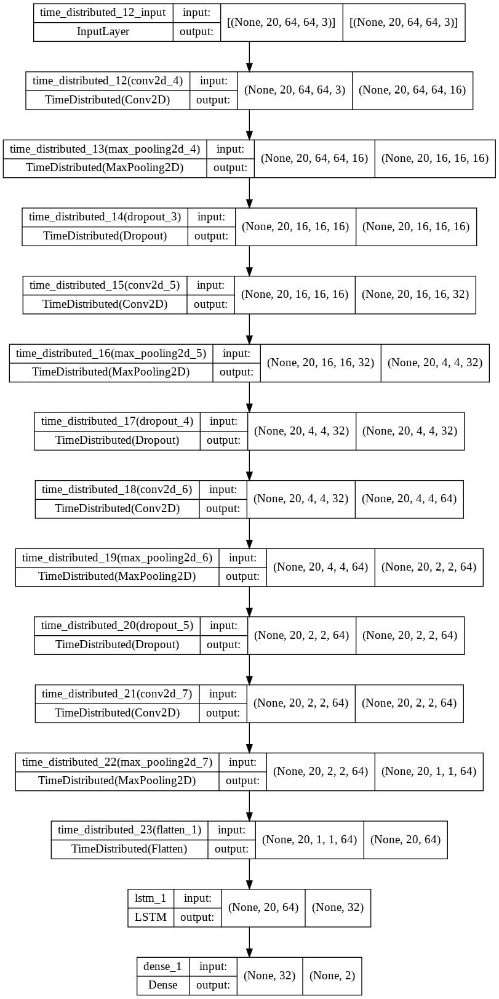

In [ ]:
# Plot the structure of the contructed LRCN model.
plot_model(LRCN_model, to_file = 'LRCN_model_structure_plot.png', show_shapes = True, show_layer_names = True)

In [ ]:
# Create an Instance of Early Stopping Callback.
early_stopping_callback = EarlyStopping(monitor = 'val_loss', patience = 15, mode = 'min', restore_best_weights = True)

# Compile the model and specify loss function, optimizer and metrics to the model.
LRCN_model.compile(loss = 'categorical_crossentropy', optimizer = 'Adam', metrics = ["accuracy"])

# Start training the model.
LRCN_model_training_history = LRCN_model.fit(x = features_train, y = labels_train, epochs = 70, batch_size = 4 ,
                                             shuffle = True, validation_split = 0.2, callbacks = [early_stopping_callback])

Epoch 1/70
39/39 [==============================] - 11s 201ms/step - loss: 0.7291 - accuracy: 0.4551 - val_loss: 0.6940 - val_accuracy: 0.4615
Epoch 2/70
39/39 [==============================] - 7s 182ms/step - loss: 0.6958 - accuracy: 0.5192 - val_loss: 0.6898 - val_accuracy: 0.5897
Epoch 3/70
39/39 [==============================] - 8s 213ms/step - loss: 0.6930 - accuracy: 0.5256 - val_loss: 0.6927 - val_accuracy: 0.5128
Epoch 4/70
39/39 [==============================] - 7s 183ms/step - loss: 0.6932 - accuracy: 0.5256 - val_loss: 0.6827 - val_accuracy: 0.5897
Epoch 5/70
39/39 [==============================] - 7s 182ms/step - loss: 0.6852 - accuracy: 0.6282 - val_loss: 0.6714 - val_accuracy: 0.5897
Epoch 6/70
39/39 [==============================] - 7s 181ms/step - loss: 0.6706 - accuracy: 0.5769 - val_loss: 0.6221 - val_accuracy: 0.6667
Epoch 7/70
39/39 [==============================] - 7s 183ms/step - loss: 0.5529 - accuracy: 0.7115 - val_loss: 0.5901 - val_accuracy: 0.7179
Epoch

In [ ]:
model_evaluation_history = LRCN_model.evaluate(features_test, labels_test)  # Evaluate the trained model.

3/3 [==============================] - 1s 222ms/step - loss: 0.2154 - accuracy: 0.9231


In [ ]:
model_evaluation_loss, model_evaluation_accuracy = model_evaluation_history  # Get the loss and accuracy from model_evaluation_history.

# Define the string date format.
# Get the current Date and Time in a DateTime Object.
# Convert the DateTime object to string according to the style mentioned in date_time_format string.
date_time_format = '%Y_%m_%d__%H_%M_%S'
current_date_time_dt = dt.datetime.now()
current_date_time_string = dt.datetime.strftime(current_date_time_dt, date_time_format)

# Define a useful name for our model to make it easy for us while navigating through multiple saved models.
model_file_name = f'LRCN_model___Date_Time_{current_date_time_string}___Loss_{model_evaluation_loss}___Accuracy_{model_evaluation_accuracy}.h5'

LRCN_model.save(model_file_name)  # Save the Model.

In [ ]:
def plot_metric(model_training_history, metric_name_1, metric_name_2, plot_name):  # This function will plot the metrics passed to it in a graph.
# model_training_history: A history object containing a record of training and validation loss values and metrics values at successive epochs
# plot_name:The title of the graph.

    # Get metric values using metric names as identifiers.
    metric_value_1 = model_training_history.history[metric_name_1]  # metric_name_1:The name of the first metric that needs to be plotted in the graph.
    metric_value_2 = model_training_history.history[metric_name_2]  # metric_name_2:The name of the second metric that needs to be plotted in the graph.


    epochs = range(len(metric_value_1)) # Construct a range object which will be used as x-axis (horizontal plane) of the graph.

    # Plot the Graph.
    plt.plot(epochs, metric_value_1, 'blue', label = metric_name_1)
    plt.plot(epochs, metric_value_2, 'red', label = metric_name_2)

    plt.title(str(plot_name))   # Add title to the plot.

    plt.legend()  # Add legend to the plot.

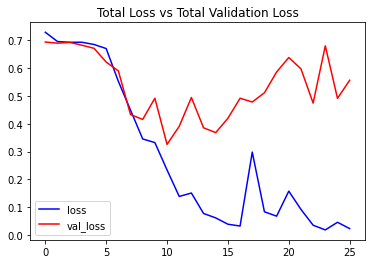

In [ ]:
# Visualize the training and validation loss metrices.
plot_metric(LRCN_model_training_history, 'loss', 'val_loss', 'Total Loss vs Total Validation Loss')

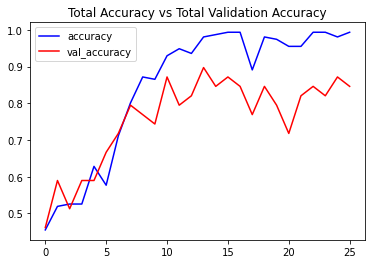

In [ ]:
# Visualize the training and validation accuracy metrices.
plot_metric(LRCN_model_training_history, 'accuracy', 'val_accuracy', 'Total Accuracy vs Total Validation Accuracy')

In [ ]:
def download_youtube_videos(youtube_video_url, output_directory):  # This function downloads the youtube video whose URL is passed to it as an argument.

        # youtube_video_url: URL of the video that is required to be downloaded.
        # output_directory:  The directory path to which the video needs to be stored after downloading.

        # title: The title of the downloaded youtube video.

     video = pafy.new(youtube_video_url)  # Create a video object which contains useful information about the video.

     title = video.title  # Retrieve the title of the video.

     video_best = video.getbest() # Get the best available quality object for the video.

     output_file_path = f'{output_directory}/{title}.mp4'  # Construct the output file path.

     # Download the youtube video at the best available quality and store it to the contructed path.
     video_best.download(filepath = output_file_path, quiet = True)

     return title   # Return the video title.

In [ ]:
# Make the Output directory if it does not exist
test_videos_directory = 'test_videos'
os.makedirs(test_videos_directory, exist_ok = True)

# Download a YouTube Video.
video_title = download_youtube_videos('https://www.youtube.com/watch?v=Cot6ZGr-pCM', test_videos_directory)

# Get the YouTube Video's path we just downloaded.
input_video_file_path = f'{test_videos_directory}/{video_title}.mp4'

In [ ]:
def predict_on_video(video_file_path, output_file_path, SEQUENCE_LENGTH):  # This function will perform action recognition on a video using the LRCN model.

    #video_file_path:  The path of the video stored in the disk on which the action recognition is to be performed.
    #output_file_path: The path where the ouput video with the predicted action being performed overlayed will be stored.
    #SEQUENCE_LENGTH:  The fixed number of frames of a video that can be passed to the model as one sequence.

    # Initialize the VideoCapture object to read from the video file.
    video_reader = cv2.VideoCapture(video_file_path)

    # Get the width and height of the video.
    original_video_width = int(video_reader.get(cv2.CAP_PROP_FRAME_WIDTH))
    original_video_height = int(video_reader.get(cv2.CAP_PROP_FRAME_HEIGHT))

    # Initialize the VideoWriter Object to store the output video in the disk.
    video_writer = cv2.VideoWriter(output_file_path, cv2.VideoWriter_fourcc('M', 'P', '4', 'V'),
                                   video_reader.get(cv2.CAP_PROP_FPS), (original_video_width, original_video_height))

    frames_queue = deque(maxlen = SEQUENCE_LENGTH)  # Declare a queue to store video frames.

    # Initialize a variable to store the predicted action being performed in the video.
    predicted_class_name = ''

    while video_reader.isOpened():  # Iterate until the video is accessed successfully.

        ok, frame = video_reader.read() # Read the frame.

        if not ok:  # Check if frame is not read properly then break the loop.
            break

        # Resize the Frame to fixed Dimensions.
        resized_frame = cv2.resize(frame, (IMAGE_HEIGHT, IMAGE_WIDTH))

        # Normalize the resized frame by dividing it with 255 so that each pixel value then lies between 0 and 1.
        normalized_frame = resized_frame / 255

        # Appending the pre-processed frame into the frames list.
        frames_queue.append(normalized_frame)

        # Check if the number of frames in the queue are equal to the fixed sequence length.
        if len(frames_queue) == SEQUENCE_LENGTH:

            # Pass the normalized frames to the model and get the predicted probabilities.
            predicted_labels_probabilities = LRCN_model.predict(np.expand_dims(frames_queue, axis = 0))[0]

            # Get the index of class with highest probability.
            predicted_label = np.argmax(predicted_labels_probabilities)

            # Get the class name using the retrieved index.
            predicted_class_name = CLASSES_LIST[predicted_label]

        # Write predicted class name on top of the frame.
        cv2.putText(frame, predicted_class_name, (10, 30), cv2.FONT_HERSHEY_SIMPLEX, 1, (0, 255, 0), 2)

        # Write The frame into the disk using the VideoWriter Object.
        video_writer.write(frame)

    # Release the VideoCapture and VideoWriter objects.
    video_reader.release()
    video_writer.release()

In [ ]:
# Construct the output video path.
output_video_file_path = f'{test_videos_directory}/{video_title}-Output-SeqLen{SEQUENCE_LENGTH}.mp4'

# Perform Action Recognition on the Test Video.
predict_on_video(input_video_file_path, output_video_file_path, SEQUENCE_LENGTH)

# Display the output video.
VideoFileClip(output_video_file_path, audio=False, target_resolution=(300,None)).ipython_display()

100%|██████████| 843/843 [00:07<00:00, 108.90it/s]


In [ ]:
def predict_single_action(video_file_path, SEQUENCE_LENGTH):  # This function will perform single action recognition prediction on a video using the LRCN model

    #video_file_path:  The path of the video stored in the disk on which the action recognition is to be performed.
    #SEQUENCE_LENGTH:  The fixed number of frames of a video that can be passed to the model as one sequence.

    video_reader = cv2.VideoCapture(video_file_path)  # Initialize the VideoCapture object to read from the video file.

    # Get the width and height of the video.
    original_video_width = int(video_reader.get(cv2.CAP_PROP_FRAME_WIDTH))
    original_video_height = int(video_reader.get(cv2.CAP_PROP_FRAME_HEIGHT))


    frames_list = []  # Declare a list to store video frames we will extract.

    # Initialize a variable to store the predicted action being performed in the video.
    predicted_class_name = ''

    video_frames_count = int(video_reader.get(cv2.CAP_PROP_FRAME_COUNT))  # Get the number of frames in the video.

    # Calculate the interval after which frames will be added to the list.
    skip_frames_window = max(int(video_frames_count/SEQUENCE_LENGTH),1)

    # Iterating the number of times equal to the fixed length of sequence.
    for frame_counter in range(SEQUENCE_LENGTH):

        # Set the current frame position of the video.
        video_reader.set(cv2.CAP_PROP_POS_FRAMES, frame_counter * skip_frames_window)

        success, frame = video_reader.read() # Read a frame.

        if not success:  # Check if frame is not read properly then break the loop.
            break

        # Resize the Frame to fixed Dimensions.
        resized_frame = cv2.resize(frame, (IMAGE_HEIGHT, IMAGE_WIDTH))

        # Normalize the resized frame by dividing it with 255 so that each pixel value then lies between 0 and 1.
        normalized_frame = resized_frame / 255

        frames_list.append(normalized_frame)   # Appending the pre-processed frame into the frames list.

    # Passing the  pre-processed frames to the model and get the predicted probabilities.
    predicted_labels_probabilities = LRCN_model.predict(np.expand_dims(frames_list, axis = 0))[0]

    predicted_label = np.argmax(predicted_labels_probabilities)  # Get the index of class with highest probability.

    predicted_class_name = CLASSES_LIST[predicted_label]  # Get the class name using the retrieved index.

    # Display the predicted action along with the prediction confidence.
    print(f'Action Predicted: {predicted_class_name}\nConfidence: {predicted_labels_probabilities[predicted_label]}')

    video_reader.release()  # Release the VideoCapture object.

In [ ]:
# Download the youtube video.
video_title = download_youtube_videos('https://www.youtube.com/watch?v=Cot6ZGr-pCM', test_videos_directory)

input_video_file_path = f'{test_videos_directory}/{video_title}.mp4'  # Construct tihe nput youtube video path.

# Perform Single Prediction on the Test Video.
predict_single_action(input_video_file_path, SEQUENCE_LENGTH)

# Display the input video.
VideoFileClip(input_video_file_path, audio=False, target_resolution=(300,None)).ipython_display()
# Printing the predicted action with the confidence value.


Action Predicted: Basketball
Confidence: 0.957974374294281


100%|██████████| 843/843 [00:09<00:00, 92.64it/s]
